In [1]:
import os
import yaml
import time
import torch 
import torch.optim as optim
from tqdm import tqdm
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import json
from geopy.distance import geodesic
from torch.utils.data import DataLoader, TensorDataset, random_split 

from models.functions_models.models_archi import *
from models.functions_models.collect_mini_cubes import * 
from models.functions_models.apply_transformation import *
from models.functions_models.fill_nan_with_mean import * 
from models.functions_models.add_current import * 
from models.functions_models.apply_bathy_mask import *

device = "cuda" if torch.cuda.is_available() else "cpu"
big_space_buffer = 200

date_buffer = 1

CNN = False
if CNN : 
    threshold = 0.5
    space_buffer = 50
else : 
    threshold = 0.99 
    space_buffer = 8

In [2]:
max_latitude = int((space_buffer/2))
max_longitude = int((space_buffer/2))

In [3]:
dataset = "from_pfts_study_reset17072025"
login = "/home/elabourdette"
path  = f'{login}/complex/gdrive/shared/Proj_FORMAL/deep_satellite/Code/CNN/pytorch_process/dataset/{dataset}/'


picture = torch.load(os.path.join(path, f'final_picture_space_200_pfts_study.pt'))
latitude = torch.load(os.path.join(path, f'final_latitude_space_200_pfts_study.pt'))
longitude = torch.load(os.path.join(path, f'final_longitude_space_200_pfts_study.pt'))
df = torch.load(os.path.join(path, f'final_df_split_pfts_study.pt'))

/tmp/ipykernel_2053901/2298076687.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  picture = torch.load(os.path.join(path, f'final_picture_space_200_pfts_study.pt'))
/tmp

In [4]:
picture.shape, latitude.shape, longitude.shape, df.shape

(torch.Size([8922, 18, 100, 550]),
 torch.Size([8922, 7, 100]),
 torch.Size([8922, 7, 550]),
 torch.Size([8922, 11]))

In [5]:
# This function is made for create small cubes from large cubes. 
def collect_mini_cubes(df_tensor, final_tensor_test, latitudes_tensor_test, longitudes_tensor_test, space_buffer,
                       max_latitude=100, max_longitude=100, device="cpu"):
    tensor_mini_cubes = []
    total_rows = df_tensor.shape[0]
    
    df_tensor = df_tensor.to(device)
    index_to_drop = []

    for index in tqdm(range(total_rows), total=total_rows, desc="Processing Data", leave=False):

        lat, lon = df_tensor[index, 0], df_tensor[index, 1]
        buf = [space_buffer, space_buffer]
        lat_inter, lon_inter = get_lon_lat_bounds_geodesic(lat, lon, buf)

        mini_cube_all_data = []  
        sum_nan = 0 
        for variable in range(final_tensor_test.shape[1]):
            tensor = final_tensor_test[index, variable, :, :].to(device)
            if tensor.shape[0] == 1:
                tensor = tensor.squeeze(0)

            # Determine method and index_lat_lon
            if variable < 4:
                index_lat_lon = 0
                method = 'other'
            elif variable == 4:
                index_lat_lon = 1
                method = 'other'
            elif variable == 5:
                index_lat_lon = 2
                method = 'other'
            elif variable == 6:
                index_lat_lon = 3
                method = 'fsle'
            elif variable < 13:
                index_lat_lon = 4
                method = 'other'
            else:
                index_lat_lon = 5
                method = 'other'

            latitude_values = latitudes_tensor_test[index, index_lat_lon, :].to(device)
            longitude_values = longitudes_tensor_test[index, index_lat_lon, :].to(device)

            mini_cube = extract_mini_cubes(tensor, latitude_values, longitude_values, lat_inter[0], lon_inter[0], method)

            if mini_cube.shape[1] == 0 or mini_cube.shape[0] == 0:
                #print(f"Variable {variable} vide à l'index {index} → remplissage avec 9999.0")
                fake_tensor = torch.full((max_latitude, max_longitude), 9999.0, device=device)
                fake_reshaped = reshape_all_same(fake_tensor, max_latitude, max_longitude, device=device)
                mini_cube_all_data.append(fake_reshaped)
                continue
               
            else:
                mini_cube_reshape = reshape_all_same(mini_cube, max_latitude, max_longitude, device=device)
                mini_cube_all_data.append(mini_cube_reshape)

        if sum_nan == 0:
            mini_cube_all_data = torch.stack(mini_cube_all_data) 
            tensor_mini_cubes.append(mini_cube_all_data)

    tensor_mini_cubes = torch.stack(tensor_mini_cubes)
    df_mini_cubes = drop_rows(df_tensor, index_to_drop, device)

    return tensor_mini_cubes.to(device), df_mini_cubes.to(device)


In [6]:
device = "cuda" if torch.cuda.is_available() else "cpu"
tensor_mini_cubes, df_mini_cubes  = collect_mini_cubes(df, picture, latitude, longitude, space_buffer, max_latitude, max_longitude, device='cpu')
tensor_mini_cubes[tensor_mini_cubes == 9999.0] = float('nan')
date_buffer = 1

In [7]:
# Study where data are missings. 
tensor_vars = [
    'SLA', 'ADT', 'U', 'V', 'SST', 'PAR', 'FSLE'
] + [f'RRS_{w}' for w in [412, 443, 490, 510, 560, 665]] + [
    'CHL', 'MICRO', 'NANO', 'PICO', 'BATHY'
]

# Vérifie que le nombre de variables correspond
assert len(tensor_vars) == tensor_mini_cubes.shape[1], "Mismatch entre noms de variables et dimensions du tenseur"

# Calcul du masque des images entièrement NaN (forme: [7031, 18])
all_nan_mask = torch.isnan(tensor_mini_cubes).all(dim=-1).all(dim=-1)

# Somme des images NaN par variable
count_all_nan_per_variable = all_nan_mask.sum(dim=0)

# Affichage
print("Nombre d'images 4x4 complètement NaN par variable :")
for name, count in zip(tensor_vars, count_all_nan_per_variable):
    print(f"{name:10s} : {count.item()} images")

Nombre d'images 4x4 complètement NaN par variable :
SLA        : 4 images
ADT        : 36 images
U          : 37 images
V          : 37 images
SST        : 9 images
PAR        : 1718 images
FSLE       : 783 images
RRS_412    : 5676 images
RRS_443    : 5676 images
RRS_490    : 5676 images
RRS_510    : 5676 images
RRS_560    : 5676 images
RRS_665    : 5676 images
CHL        : 5676 images
MICRO      : 5676 images
NANO       : 5676 images
PICO       : 5676 images
BATHY      : 16 images


In [8]:
def count_threshold_nan(tensor_mini_cubes, df_tensor, threshold=0.5, device='cpu', var_range=None):
    """
    Supprime les images où la proportion de NaN dépasse le seuil, 
    sur les variables spécifiées.

    Args:
        tensor_mini_cubes (torch.Tensor): Tenseur [N, V, H, W]
        df_tensor (torch.Tensor): DataFrame tensorisé [N, ...]
        threshold (float): Proportion maximale de NaN autorisée par variable
        device (str): CPU ou GPU
        var_range (list or None): Liste des indices de variables à tester. Si None, toutes.

    Returns:
        (tensor filtré, dataframe filtré)
    """
    tensor_mini_cubes = tensor_mini_cubes.to(device)
    df_tensor = df_tensor.to(device)

    num_images, num_variables, _, _ = tensor_mini_cubes.shape
    valid_indices = []

    if var_range is None:
        var_range = list(range(num_variables))  # Toutes les variables si rien n'est précisé

    for idx in range(num_images):
        keep_image = True
        
        for var in var_range:
            nan_mask = torch.isnan(tensor_mini_cubes[idx, var, :, :])
            nan_proportion = nan_mask.sum().item() / nan_mask.numel()

            if nan_proportion > threshold:
                keep_image = False
                break

        if keep_image:
            valid_indices.append(idx)

    valid_indices_tensor = torch.tensor(valid_indices, dtype=torch.long, device=device)
    tensor_mini_cubes_no_nan = tensor_mini_cubes[valid_indices_tensor, :, :, :]
    df_no_nan = df_tensor[valid_indices_tensor, :]

    return tensor_mini_cubes_no_nan, df_no_nan

In [9]:
tensor_no_nan, df_no_nan = count_threshold_nan(tensor_mini_cubes, df_mini_cubes, threshold)

set_column = df_no_nan[:, 9]
train_mask = set_column == 0
val_mask = set_column == 1
test_mask = set_column == 2


print(df_no_nan[train_mask].shape, df_no_nan[val_mask].shape, df_no_nan[test_mask].shape)

torch.Size([2207, 11]) torch.Size([235, 11]) torch.Size([288, 11])


In [10]:
tensor_current = add_current(tensor_no_nan)
tensor_no_cloud = fill_nan_with_mean(tensor_current, device)

In [11]:
import os
import json
import yaml
import joblib
import torch
import numpy as np
from scipy.stats import yeojohnson, boxcox
from sklearn.preprocessing import QuantileTransformer

# Read yaml files and apply transformations indicates in this file. 
def apply_transformation(tensor_mini_cubes, df, space_buffer, date_buffer,threshold=0.99, device='cpu', inference=False, save=False, CNN=False):
    tensor_mini_cubes = tensor_mini_cubes.to(device)
    df = df.to(device)
    print(inference)
    if inference == False:
        if CNN :
            path_yaml = f"./models/dataset/param_boxcox_CNN.yaml"
        else : 
            path_yaml = f"./models/dataset/param_boxcox_MLP.yaml"

        print(path_yaml)
        with open(path_yaml, "r") as file:
            transformations = yaml.safe_load(file)
    else:
        print("No already made")
        return None, None
        
    input_vars = list(transformations['DATA']['INPUT'].keys())
    output_vars = list(transformations['DATA']['OUTPUT'].keys())
    benchmark_vars = list(transformations['DATA']['BENTCHMARCK'].keys())

    tensor_vars = ['SLA', 'ADT', 'COSCURRENT', 'SINCURRENT', 'NORMCURRENT', 'SST', 'PAR', 'FSLE'] + [f'RRS_{w}' for w in [412, 443, 490, 510, 560, 665]] + ['CHL', 'MICRO', 'NANO', 'PICO','BATHY']
    var_index = {var: i for i, var in enumerate(tensor_vars)}
    df_index = {'TChla':5, 'Micro_Chla':6, 'Nano_Chla':7, 'Pico_Chla':8, 'CHL': 11, 'MICRO': 12, 'NANO': 13, 'PICO': 14}

    dico_lambda = {}
    base_save_path = f"./models/dataset/from_pfts_study_reset17072025/space_buffer_{space_buffer}_date_buffer_{date_buffer}/threshold_{threshold}/"
    os.makedirs(base_save_path, exist_ok=True)

    def process_quantile(var_name, data, is_tensor=True):
        flat_data = data.reshape(-1).clone()
        flat_data[flat_data == 9999.0] = float('nan')
        flat_data = flat_data[~torch.isnan(flat_data)].cpu().numpy().reshape(-1, 1)

        qt = QuantileTransformer(output_distribution='normal', random_state=0)
        transformed = qt.fit_transform(flat_data).flatten()

        # Sauvegarder le transformateur
        qt_path = os.path.join(base_save_path, f"{var_name}_quantile_transformer.pkl")
        joblib.dump(qt, qt_path)
        dico_lambda[f"{var_name}_quantile_path"] = qt_path

        if is_tensor:
            return torch.tensor(transformed, dtype=torch.float32).reshape(data.shape), {}
        else:
            return torch.tensor(transformed, dtype=torch.float32), {}

    for var in input_vars:
        idx = var_index.get(var)
        if idx is not None:
            for transform in transformations['DATA']['INPUT'][var]:
                name = transform['name']
                print(var, transform)
                if name == 'quantile':
                    tensor_mini_cubes[:, idx, :, :], _ = process_quantile(var, tensor_mini_cubes[:, idx, :, :], is_tensor=True)
                else:
                    tensor_mini_cubes[:, idx, :, :], stats = apply_function(name, tensor_mini_cubes[:, idx, :, :])
                    if save and name in ('normalization', 'standardization', 'yeojohnson', 'boxcox'):
                        for k, v in stats.items():
                            dico_lambda[f"{var}_{name}_{k}"] = v

    for var in benchmark_vars:
        df = torch.cat((df, torch.full((df.shape[0], 1), torch.nan, device=device)), dim=1)

    for var in benchmark_vars:
        print(var)
        idx = var_index.get(var)
        if idx is not None:
            output_data = tensor_mini_cubes[:, idx, :, :].nanmean(dim=(1, 2))

        for transform in transformations['DATA']['BENTCHMARCK'][var]:
            name = transform['name']
            if name == 'quantile':
                output_data, _ = process_quantile(var, output_data, is_tensor=False)
            else:
                output_data, stats = apply_function(name, output_data)
                if save and name in ('normalization', 'standardization', 'yeojohnson', 'boxcox'):
                    for k, v in stats.items():
                        dico_lambda[f"{var}_{name}_{k}"] = v

        df[:, df_index[var]] = output_data

    for var in output_vars:
        print(var)
        for transform in transformations['DATA']['OUTPUT'][var]:
            name = transform['name']
            print(var, transform)
            if name == 'quantile':
                df[:, df_index[var]], _ = process_quantile(var, df[:, df_index[var]], is_tensor=False)
            else:
                print(torch.min(df[:, df_index[var]]))
                df[:, df_index[var]], stats = apply_function(name, df[:, df_index[var]])
                print(torch.min(df[:, df_index[var]]))
                if save and name in ('normalization', 'standardization', 'yeojohnson', 'boxcox'):
                    for k, v in stats.items():
                        dico_lambda[f"{var}_{name}_{k}"] = v

    if save:
        dico_path = os.path.join(base_save_path, "dico_lambda_MLP.json")
        with open(dico_path, 'w') as file:
            json.dump(dico_lambda, file, indent=2)
        print("Dictionary saved at", dico_path)
        print(dico_lambda)

    return tensor_mini_cubes, df

import torch
import numpy as np
from scipy.stats import yeojohnson, boxcox

def apply_function(name, data, stats=None):
    if stats is None:
        stats = {}

    if name == 'threshold':
        return data + 1e-4, stats
    elif name == 'threshold_negative':
        return data - 1e-4, stats
    elif name == 'factor':
        return data * (2/3), stats
    elif name == 'log10':
        return torch.log10(data), stats
    elif name == 'standardization':
        if stats and 'mean' in stats and 'std' in stats:
            mean, std = stats['mean'], stats['std']
        else:
            mean = data[~torch.isnan(data)].mean()
            std = data[~torch.isnan(data)].std()
            stats = {'mean': mean.item(), 'std': std.item()}
        return (data - mean) / std, stats
    elif name == 'normalization':
        if stats and 'min' in stats and 'max' in stats:
            min_val, max_val = stats['min'], stats['max']
        else:
            min_val = data[~torch.isnan(data)].min()
            max_val = data[~torch.isnan(data)].max()
            stats = {'min': min_val.item(), 'max': max_val.item()}
        return (data - min_val) / (max_val - min_val), stats
    elif name == 'yeojohnson':
        data_np = data[~torch.isnan(data)].cpu().numpy()
        if 'lmbda' in stats:
            transformed, _ = yeojohnson(data_np, lmbda=stats['lmbda'])
        else:
            transformed, lmbda = yeojohnson(data_np)
            stats['lmbda'] = lmbda
        data_transformed = data.clone()
        data_transformed[~torch.isnan(data)] = torch.tensor(transformed, dtype=data.dtype)
        return data_transformed, stats
    elif name == 'boxcox':
        data_np = data[~torch.isnan(data)].cpu().numpy()
        if np.any(data_np <= 0):
            raise ValueError("Box-Cox transformation requires all values to be strictly positive.")
        if 'lmbda' in stats:
            transformed, _ = boxcox(data_np, lmbda=stats['lmbda'])
        else:
            transformed, lmbda = boxcox(data_np)
            stats['lmbda'] = lmbda
        data_transformed = data.clone()
        data_transformed[~torch.isnan(data)] = torch.tensor(transformed, dtype=data.dtype)
        return data_transformed, stats
    elif name == 'select_over_0.001':
        return data, stats
    elif name == 'noise_uniform_law':
        uniform_min = 4e-5
        data_transformed = data.clone()
        mask = data_transformed < uniform_min
        n_to_replace = mask.sum().item()
    
        print(f"{n_to_replace} valeurs remplacées par une loi uniforme [0, {uniform_min}]")
    
        replacements = torch.from_numpy(
            np.random.uniform(low=1e-10, high=uniform_min, size=n_to_replace)
        ).to(dtype=data.dtype, device=data.device)
    
        data_transformed[mask] = replacements
        return data_transformed, stats
    else:
        return data, stats



In [12]:
tensor_no_cloud.shape

torch.Size([2730, 19, 4, 4])

In [13]:
import joblib
inference = False 
save = True 
tensor_transf, df_transf = apply_transformation(tensor_no_cloud, df_no_nan, space_buffer, date_buffer, threshold, inference=False, save=True, CNN=CNN)
tensor_bathy = apply_bathy_mask(tensor_transf)

False
./models/dataset/param_boxcox_MLP.yaml
RRS_412 {'name': 'threshold'}
RRS_412 {'name': 'boxcox'}
RRS_412 {'name': 'standardization'}
RRS_443 {'name': 'threshold'}
RRS_443 {'name': 'boxcox'}
RRS_443 {'name': 'standardization'}
RRS_490 {'name': 'threshold'}
RRS_490 {'name': 'boxcox'}
RRS_490 {'name': 'standardization'}
RRS_510 {'name': 'threshold'}
RRS_510 {'name': 'boxcox'}
RRS_510 {'name': 'standardization'}
RRS_560 {'name': 'threshold'}
RRS_560 {'name': 'boxcox'}
RRS_560 {'name': 'standardization'}
RRS_665 {'name': 'threshold'}
RRS_665 {'name': 'boxcox'}
RRS_665 {'name': 'standardization'}
COSCURRENT {'name': 'standardization'}
SINCURRENT {'name': 'standardization'}
NORMCURRENT {'name': 'standardization'}
SLA {'name': 'standardization'}
SST {'name': 'standardization'}
PAR {'name': 'standardization'}
ADT {'name': 'standardization'}
FSLE {'name': 'standardization'}
CHL
MICRO
NANO
PICO
TChla
TChla {'name': 'select_over_0.001'}
tensor(0.0088)
tensor(0.0088)
TChla {'name': 'boxcox'}
t

In [14]:
sum(df_transf[:,9]==0), sum(df_transf[:,9]==1), sum(df_transf[:,9]==2)

(tensor(2207), tensor(235), tensor(288))

In [15]:
tensor_transf[0,:,:,:]

tensor([[[-9.9119e-02, -8.5144e-02, -7.1460e-02, -5.9232e-02],
         [-9.9119e-02, -8.5144e-02, -7.1460e-02, -5.9232e-02],
         [-9.9119e-02, -8.5144e-02, -7.1460e-02, -5.9232e-02],
         [-9.9119e-02, -8.5144e-02, -7.1460e-02, -5.9232e-02]],

        [[-2.3800e+00, -2.3758e+00, -2.3706e+00, -2.3665e+00],
         [-2.3800e+00, -2.3758e+00, -2.3706e+00, -2.3665e+00],
         [-2.3800e+00, -2.3758e+00, -2.3706e+00, -2.3665e+00],
         [-2.3800e+00, -2.3758e+00, -2.3706e+00, -2.3665e+00]],

        [[ 5.4086e-01,  5.0603e-01,  4.9746e-01,  4.8324e-01],
         [ 5.4086e-01,  5.0603e-01,  4.9746e-01,  4.8324e-01],
         [ 5.4086e-01,  5.0603e-01,  4.9746e-01,  4.8324e-01],
         [ 5.4086e-01,  5.0603e-01,  4.9746e-01,  4.8324e-01]],

        [[-1.3067e+00, -1.3190e+00, -1.3218e+00, -1.3264e+00],
         [-1.3067e+00, -1.3190e+00, -1.3218e+00, -1.3264e+00],
         [-1.3067e+00, -1.3190e+00, -1.3218e+00, -1.3264e+00],
         [-1.3067e+00, -1.3190e+00, -1.3218e+00, 

In [16]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import anderson

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import torch
import numpy as np
from scipy.stats import anderson

def plot_all_band_distributions(picture, model):
    if model == 1:
        band_names = ['SLA', 'ADT', 'U', 'V', 'SST', 'PAR', 'FSLE'] + [f'RRS_{w}' for w in [412, 443, 490, 510, 560, 665]] + [
            'CHL', 'MICRO', 'NANO', 'PICO', 'BATHY']
    else:
        band_names = ['SLA', 'ADT', 'COSCURRENT', 'SINCURRENT', 'NORMCURRENT', 'SST', 'PAR', 'FSLE'] + [f'RRS_{w}' for w in [412, 443, 490, 510, 560, 665]] + [
            'CHL', 'MICRO', 'NANO', 'PICO', 'BATHY']

    num_bands = picture.shape[1]
    assert num_bands == len(band_names), f"Le nombre de bandes ({num_bands}) ne correspond pas au nombre de noms fournis ({len(band_names)})."

    # Create subplots with 3 distributions per row
    fig = make_subplots(rows=7, cols=3, subplot_titles=band_names)

    for i in range(num_bands):
        band = picture[:, i, :, :].reshape(-1).clone()
        band[band == 9999.0] = float('nan')
        band = band[~torch.isnan(band)].cpu().numpy()

        row = (i // 3) + 1
        col = (i % 3) + 1

        if len(band) >= 20:
            test_data = band[:50000]
            result = anderson(test_data)
            stat = result.statistic
            crit_val = result.critical_values[2]
            is_normal = stat < crit_val
            label = "Normal" if is_normal else "Non-normal"
            test_result = f"{label}<br>A={stat:.2f} < {crit_val:.2f}"
        else:
            test_result = "Insuffisant"

        fig.add_trace(
            go.Histogram(x=band, name=band_names[i], nbinsx=100, marker=dict(color='skyblue'), showlegend=False),
            row=row, col=col
        )

        fig.update_xaxes(title_text=f"{band_names[i]}<br>{test_result}", row=row, col=col)

    fig.update_layout(height=1800, width=1200, title_text="Distributions des bandes", showlegend=False)
    fig.show()



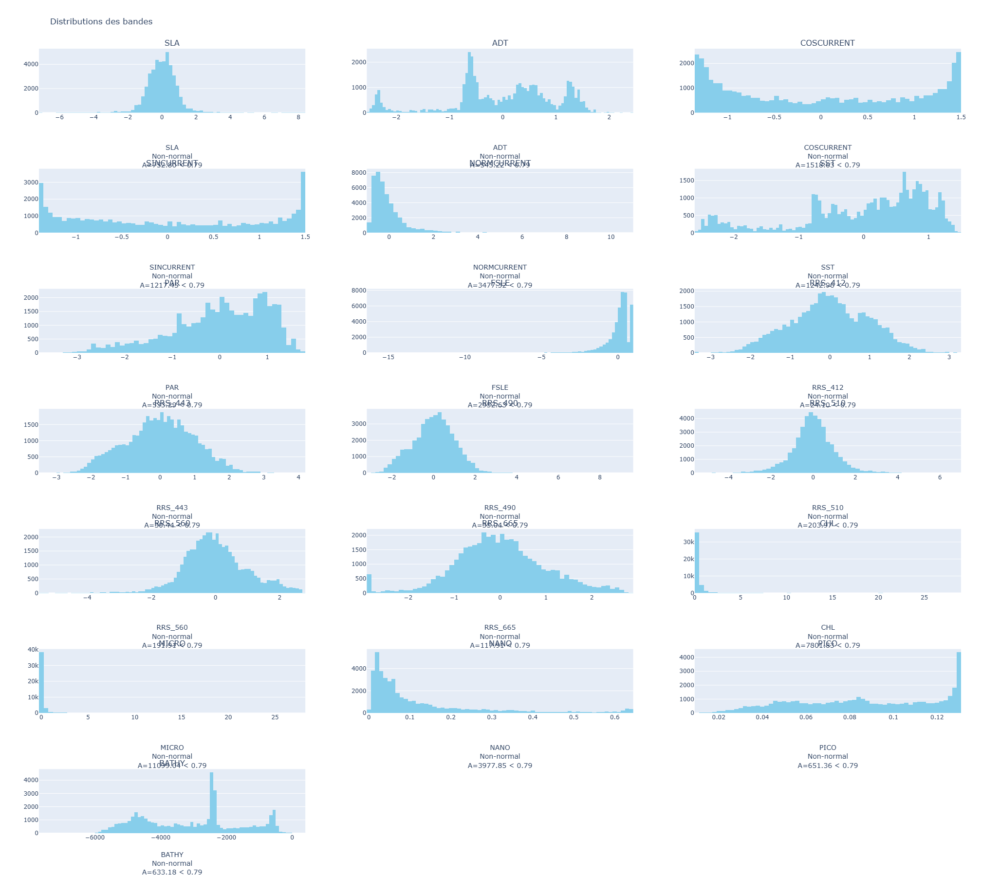

In [17]:
plot_all_band_distributions(tensor_transf, 2)

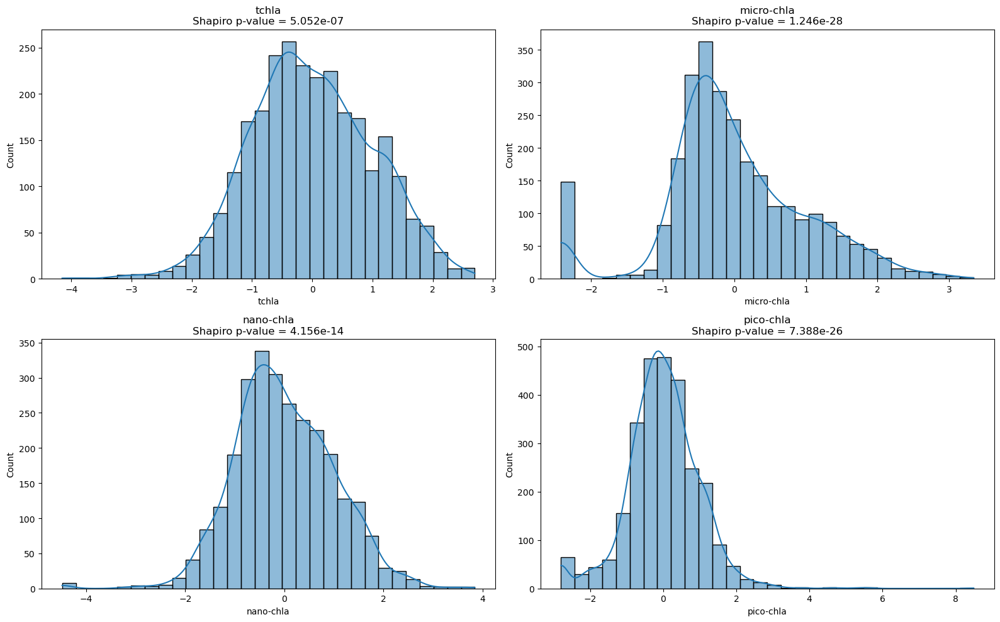

In [18]:
import torch
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from scipy.stats import shapiro

# Supposons que df_transf est ton tensor
# Colonnes à tracer
cols = [5, 6, 7, 8]
col_names = ['tchla', 'micro-chla', 'nano-chla', 'pico-chla']

df = pd.DataFrame(df_transf[:, cols].numpy(), columns=col_names)

# Plot des distributions avec p-values
plt.figure(figsize=(16, 10))
for i, col in enumerate(col_names):
    plt.subplot(2, 2, i+1)  # Ajustement pour 4 sous-graphiques
    sns.histplot(df[col], kde=True, bins=30)

    # Calcul de la p-value (test de Shapiro-Wilk)
    stat, p = shapiro(df[col].dropna())
    plt.title(f"{col}\nShapiro p-value = {p:.3e}")
    plt.tight_layout()

plt.show()

In [19]:
path  = f'./models/dataset/{dataset}/space_buffer_{space_buffer}_date_buffer_{date_buffer}/threshold_{threshold}/'
os.makedirs(path, exist_ok=True)
if CNN : 
    torch.save(tensor_bathy, os.path.join(path,f"final_picture_{space_buffer*2}x{space_buffer*2}_CNN_boxcox.pt"))
    torch.save(df_transf, os.path.join(path,f"final_df_{space_buffer*2}x{space_buffer*2}_CNN_boxcox.pt"))
else : 
    torch.save(tensor_bathy, os.path.join(path,f"final_picture_{space_buffer*2}x{space_buffer*2}_MLP_boxcox.pt"))
    torch.save(df_transf, os.path.join(path,f"final_df_{space_buffer*2}x{space_buffer*2}_MLP_boxcox.pt"))